In [1]:
import xarray as xr
import dask
import numpy as np
import hvplot.xarray
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt


%load_ext autoreload
%autoreload 2
from anndata import AnnData
import squidpy as sq
import scanpy as sc
from cellpose import models, io
import matplotlib.pyplot as plt
from modest_image import ModestImage, imshow
from skimage.restoration import inpaint
#%matplotlib widget
import cv2
import torch
from skimage import io, morphology
import skimage.feature as features
from scipy import ndimage
import time
from tqdm.notebook import tqdm
import scipy
import seaborn as sns

import skimage
from skimage.measure import regionprops, regionprops_table, approximate_polygon
from shapely.geometry import Polygon
from shapely.geometry.polygon import LinearRing
import geopandas
import scanpy as sc
import rasterio
from rasterio import features
import shapely
from shapely.geometry import Point, Polygon
import matplotlib
from matplotlib.colors import Normalize

from napari_sparrow import functions as fc
from dask.distributed import Client

napari.manifest -> 'napari-spongepy' could not be imported: Cannot find module 'napari_spongepy' declared in entrypoint: 'napari_spongepy:napari.yaml'
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/geopandas/_compat.py:112: UserWarning: The Shapely GEOS version (3.11.0-CAPI-1.17.0) is incompatible with the GEOS version PyGEOS was compiled with (3.10.3-CAPI-1.16.1). Conversions between both will be slow.
  warnings.warn(


# This notebook isn't cleaned up, you actually just need the match_membrane function

In [2]:
path_adata='/srv/scratch/lottep/vizgen/vizgen_Subset_45000.h5ad'
path_geopandas='/srv/scratch/lottep/vizgen/vizgen_Subset_20000.geojson'
path_adataP='/srv/scratch/lottep/vizgen/vizgen_Subset_45000_polyT.h5ad'
path_geopandasP='/srv/scratch/lottep/vizgen/vizgen_Subset_45000_polyT.geojson'

In [3]:
adataD = sc.read(path_adata)
geop = geopandas.read_file(path_geopandas,index_col=0)

/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/anndata/_core/anndata.py:121: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)


In [4]:
geop.index=geop['index']
adataD.obsm['polygons']=geop
adataD.obsm['polygons']['linewidth']=1

In [5]:
adataP = sc.read(path_adataP)
geop = geopandas.read_file(path_geopandasP,index_col=0)
geop.index=geop['index']
adataP.obsm['polygons']=geop
adataP.obsm['polygons']['linewidth']=1

In [6]:
adataP

AnnData object with n_obs × n_vars = 72517 × 347
    obs: 'cell_ID', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_2_genes', 'pct_counts_in_top_5_genes', 'n_counts', 'nucleusSize', 'leiden', 'Tot_Rank_Endothelial cells', 'Tot_Rank_Stromal cells', 'Tot_Rank_Hepatocytes', 'Tot_Rank_Cholangiocytes', 'Tot_Rank_HsPCs', 'Tot_Rank_cDC2s', 'Tot_Rank_Mig. cDCs', 'Tot_Rank_Monocytes and Monocytes-derived cells', 'Tot_Rank_Neutrophils', 'Tot_Rank_Basophils', 'Tot_Rank_NK cells', 'Tot_Rank_ILC1s', 'Tot_Rank_T cells', 'Tot_Rank_pDCs', 'Tot_Rank_B cells', 'Tot_Rank_cDC1s', 'Tot_Rank_Kuppfer cells', 'Cleanliness', 'maxScores'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'mean', 'std'
    uns: 'leiden', 'leiden_colors', 'log1p', 'maxScores_colors', 'neighbors', 'pca', 'rank_genes_groups', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'pol

In [7]:
adataD

AnnData object with n_obs × n_vars = 74099 × 347
    obs: 'cell_ID', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_2_genes', 'pct_counts_in_top_5_genes', 'n_counts', 'nucleusSize', 'leiden'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'polygons'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [8]:
adataP.obs.total_counts.median()

961.0

In [9]:
adataD.obs.total_counts.median()

563.0

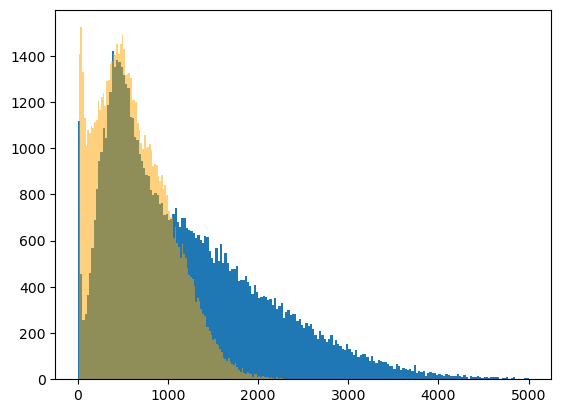

In [10]:
plt.hist(adataP.obs.total_counts,bins=200,range=[0,5000])
plt.hist(adataD.obs.total_counts,bins=200,color='orange',alpha=0.5);

In [11]:
sc.pp.filter_cells(adataD,min_counts=70)

In [12]:
adataP

AnnData object with n_obs × n_vars = 72517 × 347
    obs: 'cell_ID', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_2_genes', 'pct_counts_in_top_5_genes', 'n_counts', 'nucleusSize', 'leiden', 'Tot_Rank_Endothelial cells', 'Tot_Rank_Stromal cells', 'Tot_Rank_Hepatocytes', 'Tot_Rank_Cholangiocytes', 'Tot_Rank_HsPCs', 'Tot_Rank_cDC2s', 'Tot_Rank_Mig. cDCs', 'Tot_Rank_Monocytes and Monocytes-derived cells', 'Tot_Rank_Neutrophils', 'Tot_Rank_Basophils', 'Tot_Rank_NK cells', 'Tot_Rank_ILC1s', 'Tot_Rank_T cells', 'Tot_Rank_pDCs', 'Tot_Rank_B cells', 'Tot_Rank_cDC1s', 'Tot_Rank_Kuppfer cells', 'Cleanliness', 'maxScores'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells', 'mean', 'std'
    uns: 'leiden', 'leiden_colors', 'log1p', 'maxScores_colors', 'neighbors', 'pca', 'rank_genes_groups', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'pol

In [13]:
adataD

AnnData object with n_obs × n_vars = 72673 × 347
    obs: 'cell_ID', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_2_genes', 'pct_counts_in_top_5_genes', 'n_counts', 'nucleusSize', 'leiden'
    var: 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_cells'
    uns: 'leiden', 'leiden_colors', 'log1p', 'neighbors', 'pca', 'rank_genes_groups', 'spatial', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'polygons'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

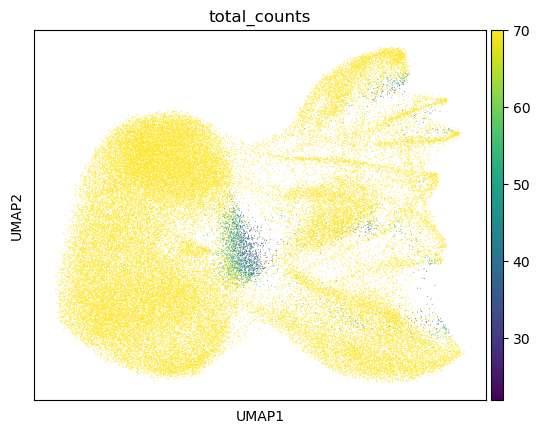

In [14]:
sc.pl.umap(adataD,color='total_counts',vmax=70)

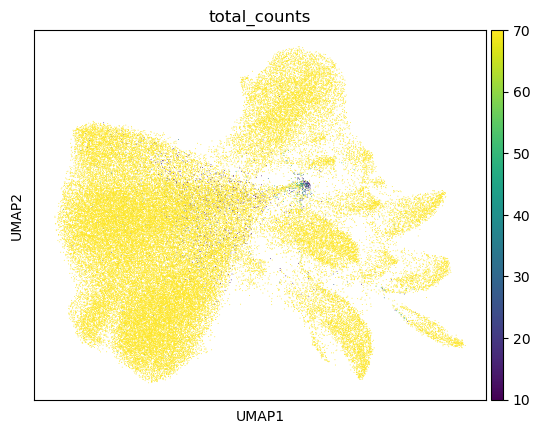

In [15]:
sc.pl.umap(adataP,color='total_counts',vmax=70)

## Annotate the cells in adataP

/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/scanpy/tools/_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and 

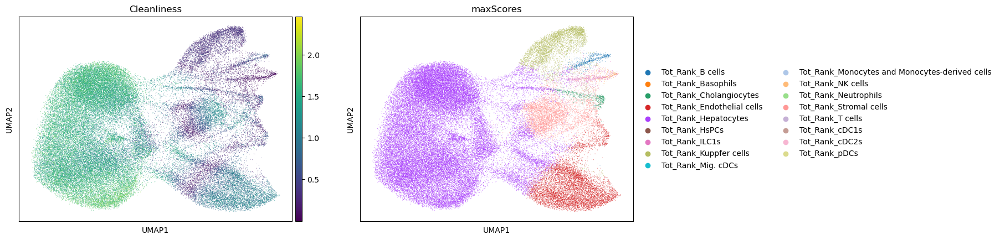

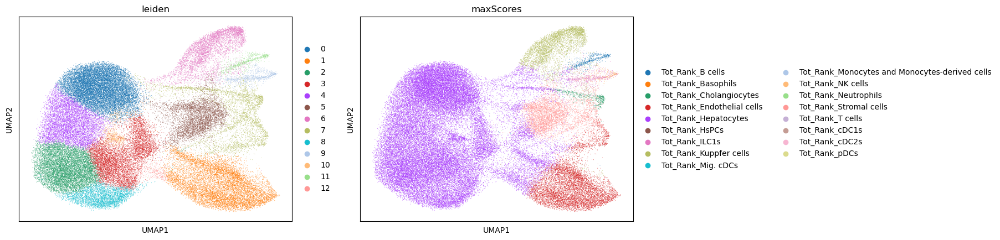

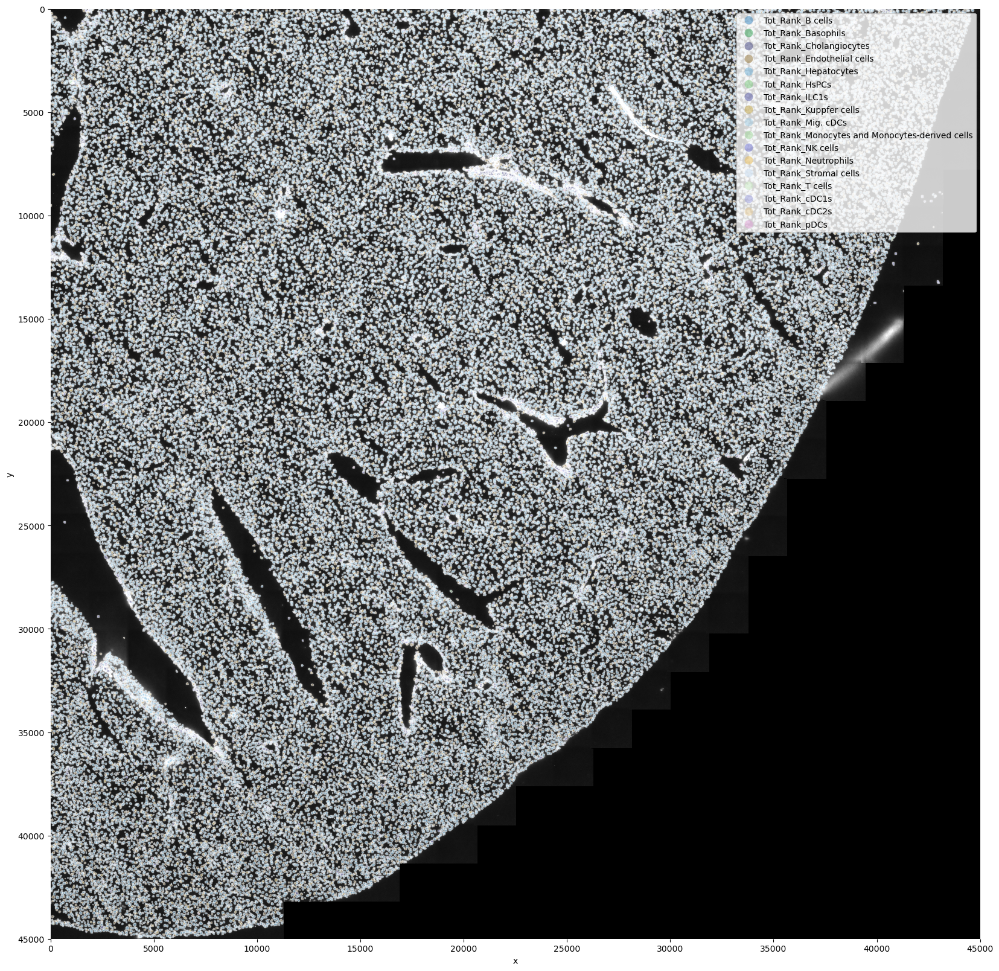

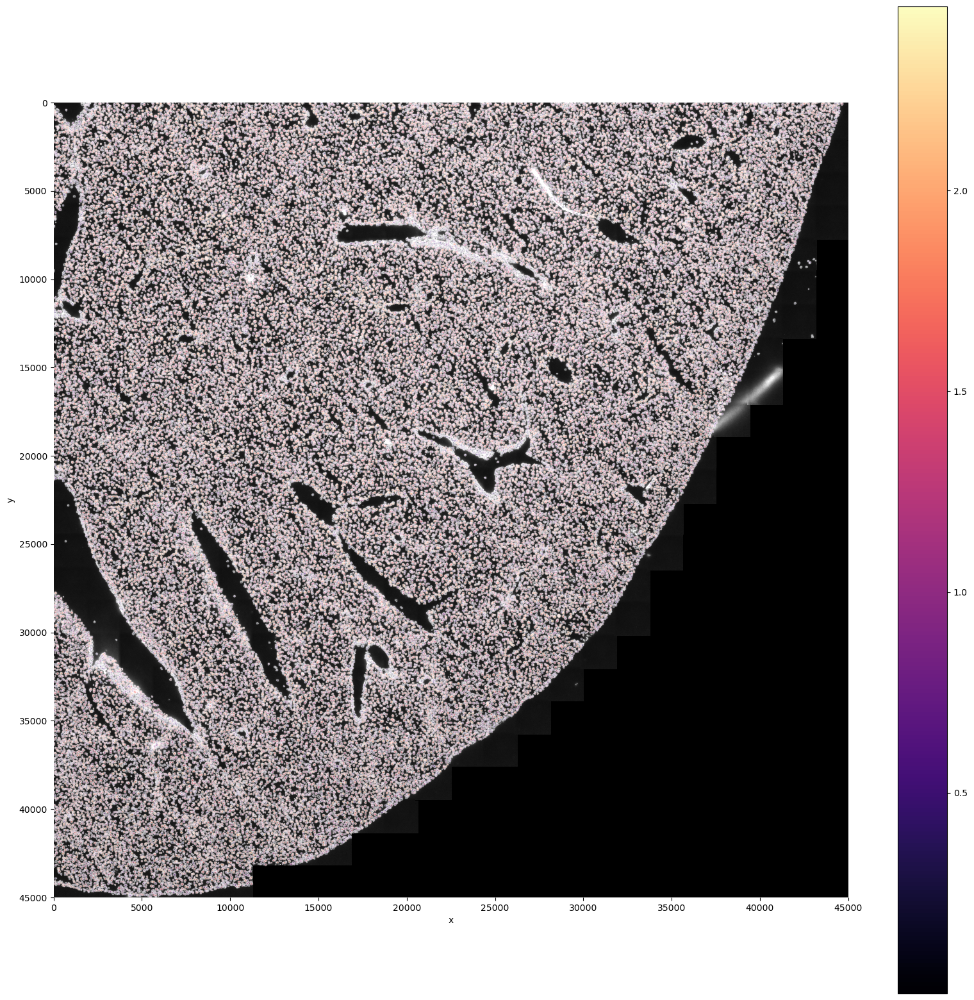

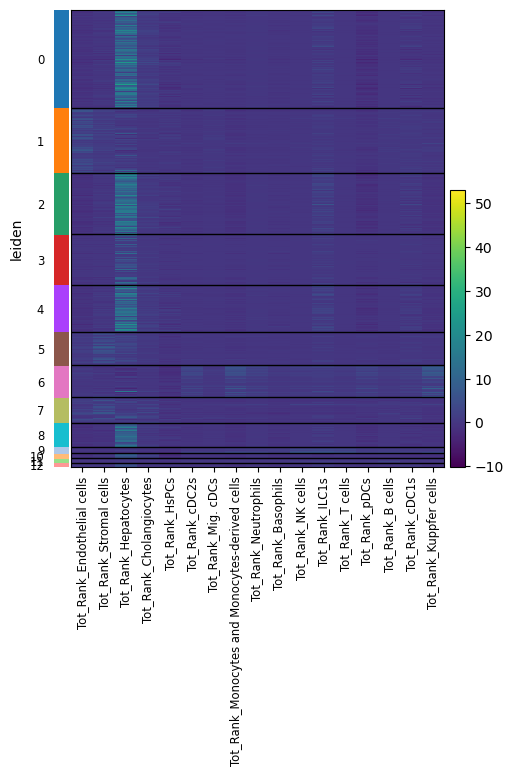

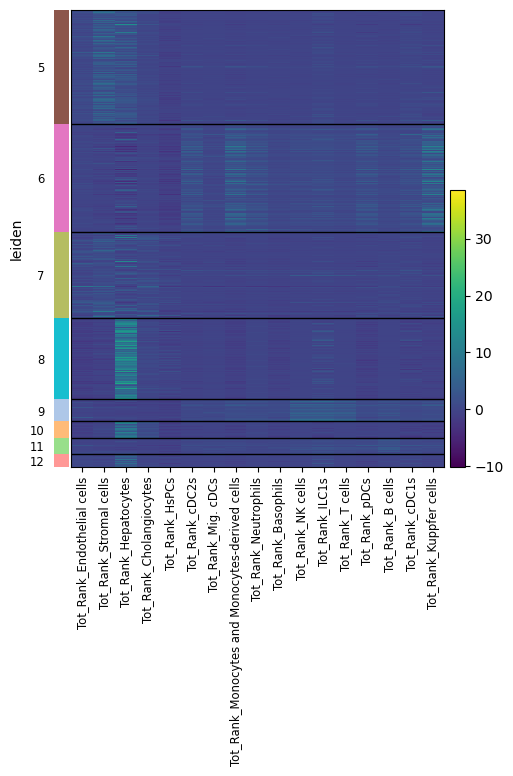

In [16]:
path_mg = "/srv/scratch/lottep/vizgen/markerGenesVizgen.csv"

mg_dict, scoresper_cluster = fc.scoreGenes(adataD, path_mg, repl_columns={"Tot_Score_": ""})
fc.scoreGenesPlot(adataD, scoresper_cluster, 5)

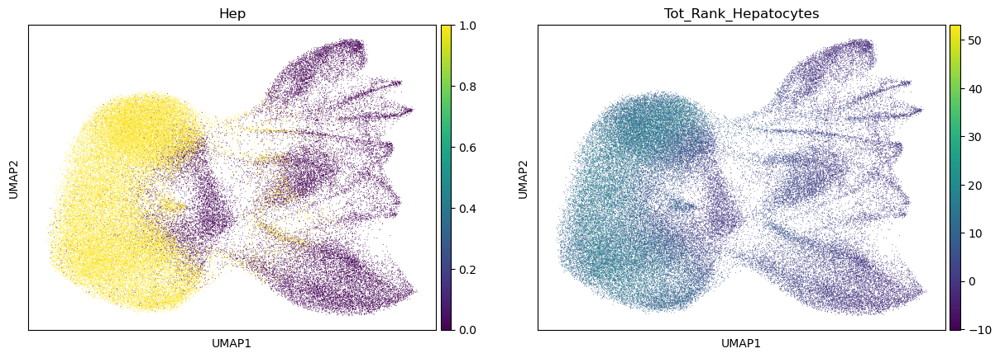

In [17]:
adataD.obs["Hep"] = (adataD.obs["Tot_Rank_Hepatocytes"]>4).astype(int)
sc.pl.umap(adataD, color=["Hep","Tot_Rank_Hepatocytes"])

In [18]:
adataD = fc.correct_marker_genes(adataD, {"Tot_Rank_Hepatocytes": (4, 5)})

/srv/scratch/lottep/tryout_spongepy/napari-spongepy/src/napari_sparrow/functions.py:1077: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs[gene].iloc[i] = adata.obs[gene].iloc[i] / values[1]


# Determine for every DAPI the correct membrane cell

In [19]:
def match_membrane(adataNuc,adataCell,cutoff=0):
    """Find for every cell in the first dataframe the matching cell in the second dataframe. 
    For some cells, no matching cells are found, those will get NaN's and should be dealt with. Some nuclei will get the same polyT stained cell, these are binucleated. 
    The cutoff decides the minimal overlap between the cells to be seen as overlapping. 0.5 is generally chosen to prevent two cells overlapping."""
    # Create geopandas objects with all info we need from the anndata object
    geopD=geopandas.GeoDataFrame(adataNuc.obsm['polygons'].geometry,geometry=adataNuc.obsm['polygons'].geometry)
    geopP=geopandas.GeoDataFrame(adataCell.obsm['polygons'].geometry,geometry=adataCell.obsm['polygons'].geometry)
    
    #join based on interesects to see which nuclei overlap with which cells, these are the only possible matchups
    possibilities=geopandas.sjoin(geopD,geopP,predicate='intersects',how='left')
    #For now filter out the nucleis that don't overlap with any cell
    Vclean=possibilities.loc[possibilities.index_right.isnull()==False,:]
    
    # Create an empty dataframe with all the nuclei, also the ones that don't match up. 
    polyT_match=pd.DataFrame(data=None,index=geopD.index)
    
    # Caclulate how much of the area is overlapping with all possible matches 
    Vclean['matchedArea']=Vclean.intersection(geopP.loc[Vclean.index_right],align=False).area/Vclean.area
    #filter out all matches that have less then cutoff in common 
    Vclean=Vclean.loc[Vclean.matchedArea>cutoff,:]
    Vclean.index=Vclean.index.rename('index')
    
    # for every nucleus, oly keep the most overlapping celll. 
    temp=Vclean.sort_values('matchedArea', ascending=False).loc[~Vclean.sort_values('matchedArea', ascending=False).index.duplicated(keep='first'),:]
    temp.index=temp.index.rename('index')
    
    polyT_match.index=polyT_match.index.rename('index')
    
    # Add this informatien to the empty pandas dataframe: in this way, the Nan's  are included
    polyT_match=polyT_match.merge(temp,how='left',on='index')
    polyT_match.drop(columns=['geometry'],inplace=True)
    
    return polyT_match


In [20]:
match=match_membrane(adataD,adataP,0.5)

/tmp/ipykernel_31114/3428901485.py:16: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  Vclean['matchedArea']=Vclean.intersection(geopP.loc[Vclean.index_right],align=False).area/Vclean.area
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/geopandas/geodataframe.py:1472: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [21]:
match_filtered=match[~match['index_right'].isna()]


In [22]:
match['annotationDAPI']=adataD.obs.maxScores
match_filtered=match[~match['index_right'].isna()]
match_filtered['annotation_polyT']=adataP.obs.loc[match_filtered['index_right'],:].maxScores.values
match_filtered['counts_DAPI']=adataD.obs.loc[match_filtered.index,:].total_counts.values
match_filtered['counts_PolyT']=adataP.obs.loc[match_filtered.index_right,:].total_counts.values
match_filtered['nuc_size_DAPI']=adataD.obs.loc[match_filtered.index,:].nucleusSize.values
match_filtered['nuc_size_PolyT']=adataP.obs.loc[match_filtered.index_right,:].nucleusSize.values

/tmp/ipykernel_31114/3734003773.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  match_filtered['annotation_polyT']=adataP.obs.loc[match_filtered['index_right'],:].maxScores.values
/tmp/ipykernel_31114/3734003773.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  match_filtered['counts_DAPI']=adataD.obs.loc[match_filtered.index,:].total_counts.values
/tmp/ipykernel_31114/3734003773.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexe

In [23]:
np.sum(match_filtered['annotation_polyT']!=match_filtered['annotationDAPI'])/len(match_filtered)

0.06660749817484289

In [24]:
to_plot=match_filtered[match_filtered['annotation_polyT']!=match_filtered['annotationDAPI']].groupby(['annotation_polyT','annotationDAPI']).count()

In [25]:
toplot2=to_plot['index_right'].reset_index().pivot(columns='annotationDAPI',values='index_right',index='annotation_polyT')

<AxesSubplot:xlabel='annotationDAPI', ylabel='annotation_polyT'>

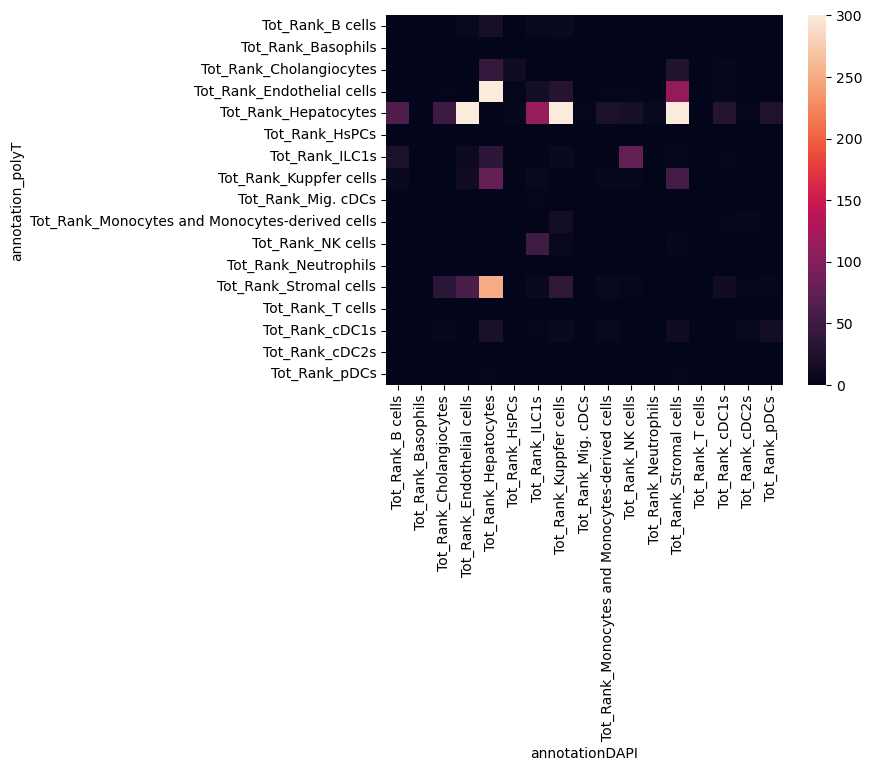

In [26]:
sns.heatmap(toplot2,vmax=300)

In [32]:
adataD_sub=adataD[match_filtered.index,:]
adataD_sub.obs['index_PolyT']=match_filtered.index_right

/tmp/ipykernel_31114/476587937.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adataD_sub.obs['index_PolyT']=match_filtered.index_right


In [27]:
adataP_sub=adataP[match_filtered.index_right,:]
adataP_sub.obs['index_DAPI']=match_filtered.index

/tmp/ipykernel_31114/1229601709.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adataP_sub.obs['index_DAPI']=match_filtered.index
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
  utils.warn_names_duplicates("obs")
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/contextlib.py:142: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  next(self.gen)
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/anndata/_core/anndata.py:1828: UserWarning: Observation names are not unique. To make them unique, call `.obs_names_make_unique`.
 

In [33]:
adataP_sub.obsm['polygons']=geopandas.GeoDataFrame(adataP_sub.obsm['polygons'].geometry,geometry=adataP_sub.obsm['polygons'].geometry)
adataD_sub.obsm['polygons']=geopandas.GeoDataFrame(adataD_sub.obsm['polygons'].geometry,geometry=adataD_sub.obsm['polygons'].geometry)


In [34]:
adataP_sub.obsm['polygons']['linewidth']=1
adataD_sub.obsm['polygons']['linewidth']=1


In [35]:
fc.save_data(adataP_sub,'/srv/scratch/lottep/vizgen/vizgen_Subset_45000_adataP_sub.geojson','/srv/scratch/lottep/vizgen/vizgen_Subset_45000_adataP_sub.h5ad')

In [36]:
fc.save_data(adataD_sub,'/srv/scratch/lottep/vizgen/vizgen_Subset_45000_adataD_sub.geojson','/srv/scratch/lottep/vizgen/vizgen_Subset_45000_adataD_sub.h5ad')

<AxesSubplot:ylabel='Frequency'>

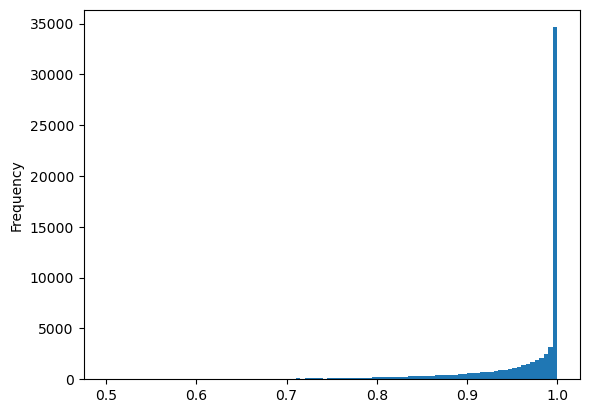

In [21]:
match.matchedArea.plot.hist(bins=100)

In [23]:
match.matchedArea.median()

0.9946091644204852

In [36]:
len(match_filtered)/len(match) # the amount of DAPI-stained images with a matched membrane stain. 

0.9612510836211523

(200.0, 1800.0)

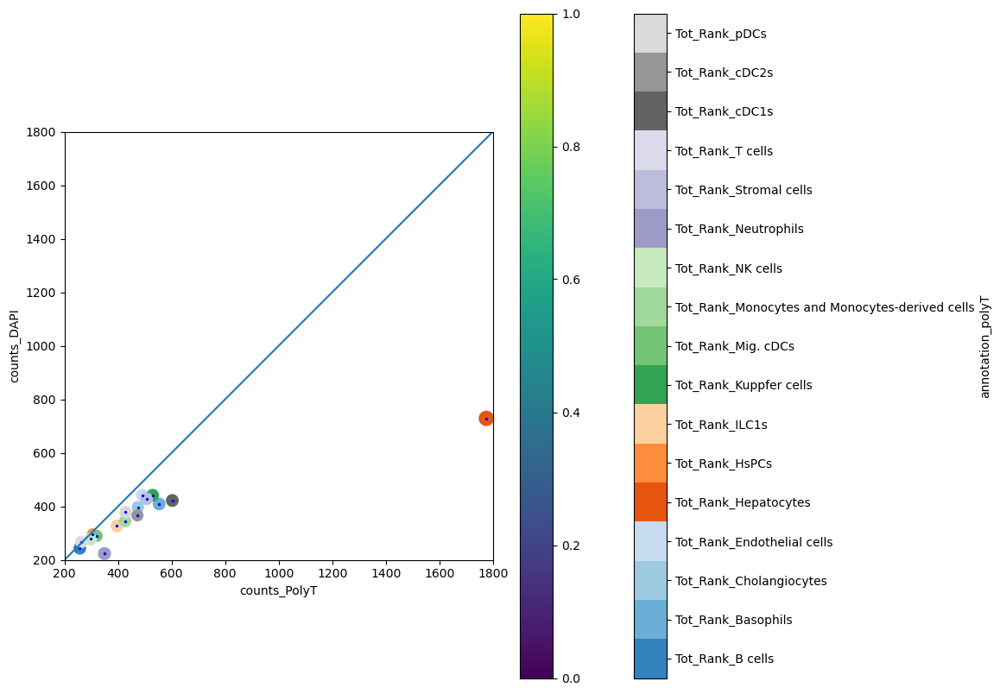

In [76]:
temp=match_filtered.groupby('annotation_polyT').mean()
temp['annotation_polyT']=temp.index
temp.nuc_size_PolyT=np.sqrt(temp.nuc_size_PolyT)
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
temp.plot.scatter(x='counts_PolyT',y='counts_DAPI',colormap='tab20c',s='nuc_size_PolyT',c='annotation_polyT',ax=ax)
temp.plot.scatter(x='counts_PolyT',y='counts_DAPI',colormap='tab20c',s=2,c='b',ax=ax)
ax.axis('scaled')
ax.plot([0, 1], [0, 1], transform=ax.transAxes)
plt.xlim(200, 1800)
plt.ylim(200, 1800)

In [83]:
temp2=match_filtered.groupby('annotation_polyT').count()
temp2

,index_right,matchedArea,annotationDAPI,counts_DAPI,counts_PolyT,nuc_size_DAPI,nuc_size_PolyT
annotation_polyT,,,,,,,
Tot_Rank_B cells,530,530,530,530,530,530,530
Tot_Rank_Basophils,3,3,3,3,3,3,3
Tot_Rank_Cholangiocytes,445,445,445,445,445,445,445
Tot_Rank_Endothelial cells,7230,7230,7230,7230,7230,7230,7230
Tot_Rank_Hepatocytes,52523,52523,52523,52523,52523,52523,52523
Tot_Rank_HsPCs,6,6,6,6,6,6,6
Tot_Rank_ILC1s,642,642,642,642,642,642,642
Tot_Rank_Kuppfer cells,3392,3392,3392,3392,3392,3392,3392
Tot_Rank_Mig. cDCs,20,20,20,20,20,20,20


(2000.0, 20000.0)

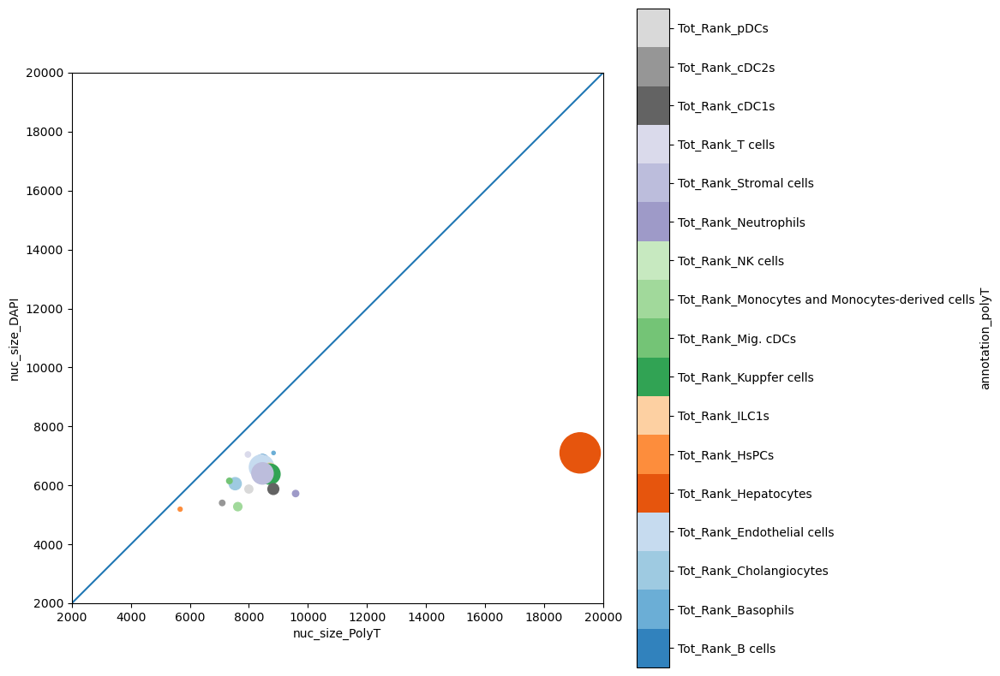

In [88]:
temp=match_filtered.groupby('annotation_polyT').mean()
temp['annotation_polyT']=temp.index
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
temp.plot.scatter(x='nuc_size_PolyT',y='nuc_size_DAPI',colormap='tab20c',s=5*np.sqrt(temp2.index_right),c='annotation_polyT',ax=ax)
ax.axis('scaled')
ax.plot([0, 1], [0, 1], transform=ax.transAxes)
plt.xlim(2000, 20000)
plt.ylim(2000, 20000)

(200.0, 1800.0)

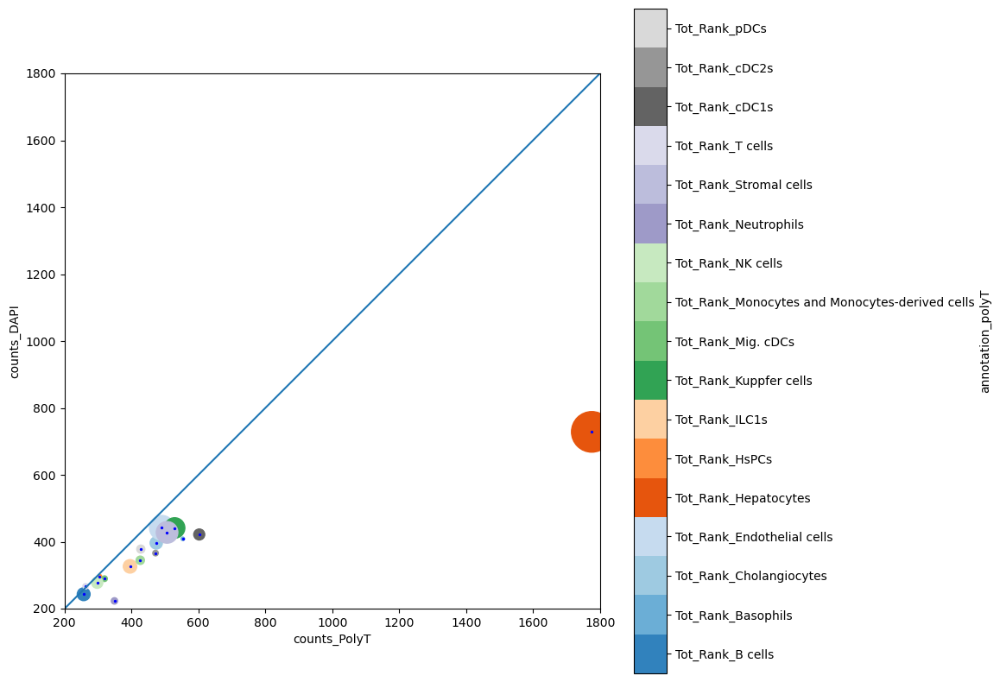

In [99]:
temp=match_filtered.groupby('annotation_polyT').mean()
temp['annotation_polyT']=temp.index
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
temp.plot.scatter(x='counts_PolyT',y='counts_DAPI',colormap='tab20c',s=5*np.sqrt(temp2.index_right),c='annotation_polyT',ax=ax)
temp.plot.scatter(x='counts_PolyT',y='counts_DAPI',s=2,c='b',ax=ax)
ax.axis('scaled')
ax.plot([0, 1], [0, 1], transform=ax.transAxes)
plt.xlim(200, 1800)
plt.ylim(200, 1800)

Text(0.5, 1.0, 'The transcript density of the nucleus compared to the transcript density of the whole cell, per celltype')

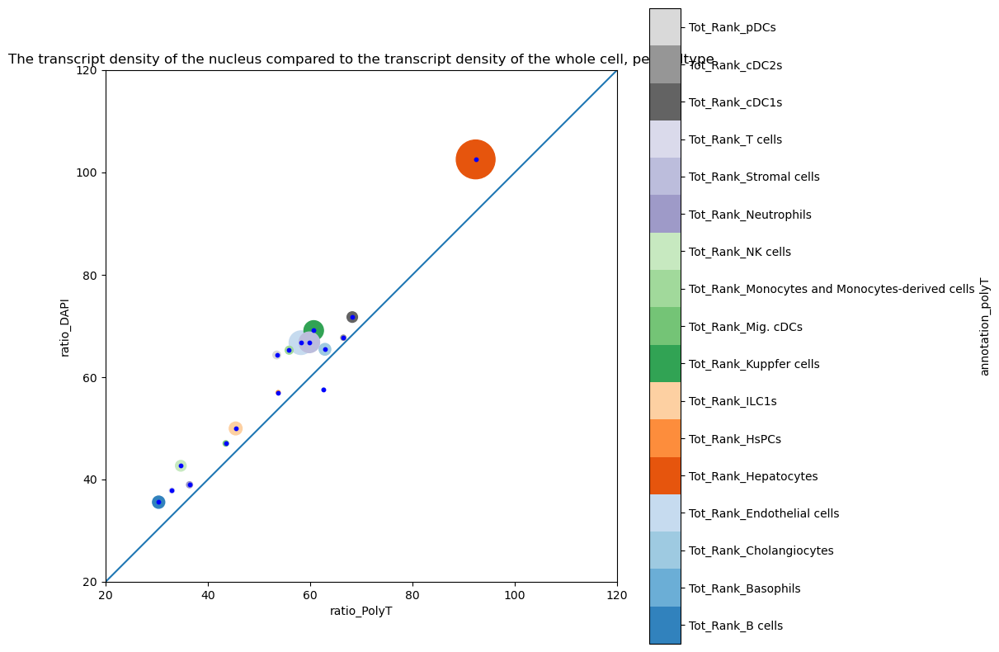

In [100]:
temp['ratio_DAPI']=1000*temp.counts_DAPI/ temp.nuc_size_DAPI
temp['ratio_PolyT']=1000*temp.counts_PolyT/ temp.nuc_size_PolyT
fig, ax = plt.subplots(1, 1, figsize=(10, 10))
temp.plot.scatter(x='ratio_PolyT',y='ratio_DAPI',colormap='tab20c',s=5*np.sqrt(temp2.index_right),c='annotation_polyT',ax=ax)
temp.plot.scatter(x='ratio_PolyT',y='ratio_DAPI',s=10,c='b',ax=ax)

ax.axis('scaled')
ax.plot([0, 1], [0, 1], transform=ax.transAxes)
plt.xlim(20, 120)
plt.ylim(20, 120)
plt.title('The transcript density of the nucleus compared to the transcript density of the whole cell, per celltype')

catter like this, but bolletje per celltype, look at the size of the cells. So size of bolletje is size of average cell for that celltype. 


<AxesSubplot:xlabel='counts_PolyT', ylabel='counts_DAPI'>

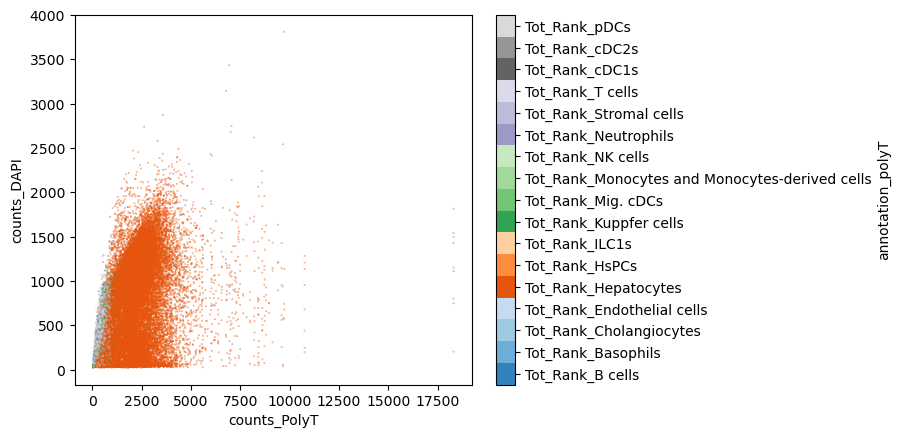

In [52]:
match_filtered.plot.scatter(x='counts_PolyT',y='counts_DAPI',c='annotation_polyT',colormap='tab20c',s=0.05)

In [ ]:
match_filtered['ratio_transcripts']=match_filtered.counts_DAPI/match_filtered.counts_PolyT

In [ ]:
np.sum(match_filtered.ratio_transcripts>1)/len(match_filtered) # 11 percent of the cases more counts in DAPI 

In [ ]:
match_filtered.ratio_transcripts.plot.hist(bins=50,range=(0,2.5),edgecolor='k')
plt.axvline(match_filtered.ratio_transcripts.mean(), color='k', linestyle='dashed', linewidth=1)
plt.text(match_filtered.ratio_transcripts.mean()*1.1, 5000, 'Mean: {:.2f}'.format(match_filtered.ratio_transcripts.mean()))

In [ ]:
match_filtered.groupby(['annotation_polyT']).mean()['ratio_transcripts'].plot.bar()
plt.axhline(1, color='k', linestyle='dashed', linewidth=1)


In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 10))
sns.boxplot(data=match_filtered,x='annotation_polyT',y='ratio_transcripts',ax=ax)
ax.axhline(1, color='k', linestyle='dashed', linewidth=1)
plt.xticks(rotation=90)


In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(20, 10))
sns.boxplot(data=match_filtered,x='annotationDAPI',y='ratio_transcripts',ax=ax)
ax.axhline(1, color='k', linestyle='dashed', linewidth=1)
ax.axhline(match_filtered.ratio_transcripts.mean(), color='red', linestyle='dashed', linewidth=1)

plt.xticks(rotation=90)

In [ ]:
match_filtered['annotation_polyT']=adataP.obs.loc[match_filtered['index_right'],:].maxScores.values

In [ ]:
match_filtered['counts_DAPI']=adataD.obs.loc[match_filtered.index,:].total_counts.values
match_filtered['counts_PolyT']=adataP.obs.loc[match_filtered.index_right,:].total_counts.values

In [ ]:
match_filtered['nuc_size_DAPI']=adataD.obs.loc[match_filtered.index,:].nucleusSize.values
match_filtered['nuc_size_PolyT']=adataP.obs.loc[match_filtered.index_right,:].nucleusSize.values

In [107]:
match_f$!['ratio_size']=match_filtered.nuc_size_DAPI/match_filtered.nuc_size_PolyT

AttributeError: 'DataFrame' object has no attribute 'nuc_nize_PolyT'

In [37]:
df_heatmap=match_filtered.groupby(['annotationDAPI','annotation_polyT']).count()['index_right'].unstack()

In [38]:
df_heatmap=df_heatmap/df_heatmap.sum()

In [39]:
match_filtered.annotation_polyT.value_counts()/len(match_filtered)

Tot_Rank_Hepatocytes                              0.751865
Tot_Rank_Endothelial cells                        0.103497
Tot_Rank_Stromal cells                            0.060438
Tot_Rank_Kuppfer cells                            0.048556
Tot_Rank_ILC1s                                    0.009190
Tot_Rank_B cells                                  0.007587
Tot_Rank_Cholangiocytes                           0.006370
Tot_Rank_NK cells                                 0.004409
Tot_Rank_cDC1s                                    0.004094
Tot_Rank_Monocytes and Monocytes-derived cells    0.001374
Tot_Rank_pDCs                                     0.001217
Tot_Rank_Neutrophils                              0.000472
Tot_Rank_Mig. cDCs                                0.000286
Tot_Rank_cDC2s                                    0.000272
Tot_Rank_T cells                                  0.000243
Tot_Rank_HsPCs                                    0.000086
Tot_Rank_Basophils                                0.0000

In [40]:
match_filtered.annotationDAPI.value_counts()/len(match_filtered)

Tot_Rank_Hepatocytes                              0.720629
Tot_Rank_Endothelial cells                        0.116653
Tot_Rank_Stromal cells                            0.070272
Tot_Rank_Kuppfer cells                            0.053710
Tot_Rank_ILC1s                                    0.009877
Tot_Rank_B cells                                  0.008389
Tot_Rank_Cholangiocytes                           0.006413
Tot_Rank_NK cells                                 0.005025
Tot_Rank_cDC1s                                    0.003736
Tot_Rank_pDCs                                     0.001718
Tot_Rank_Monocytes and Monocytes-derived cells    0.001661
Tot_Rank_Neutrophils                              0.000544
Tot_Rank_cDC2s                                    0.000458
Tot_Rank_HsPCs                                    0.000387
Tot_Rank_Mig. cDCs                                0.000272
Tot_Rank_T cells                                  0.000215
Tot_Rank_Basophils                                0.0000

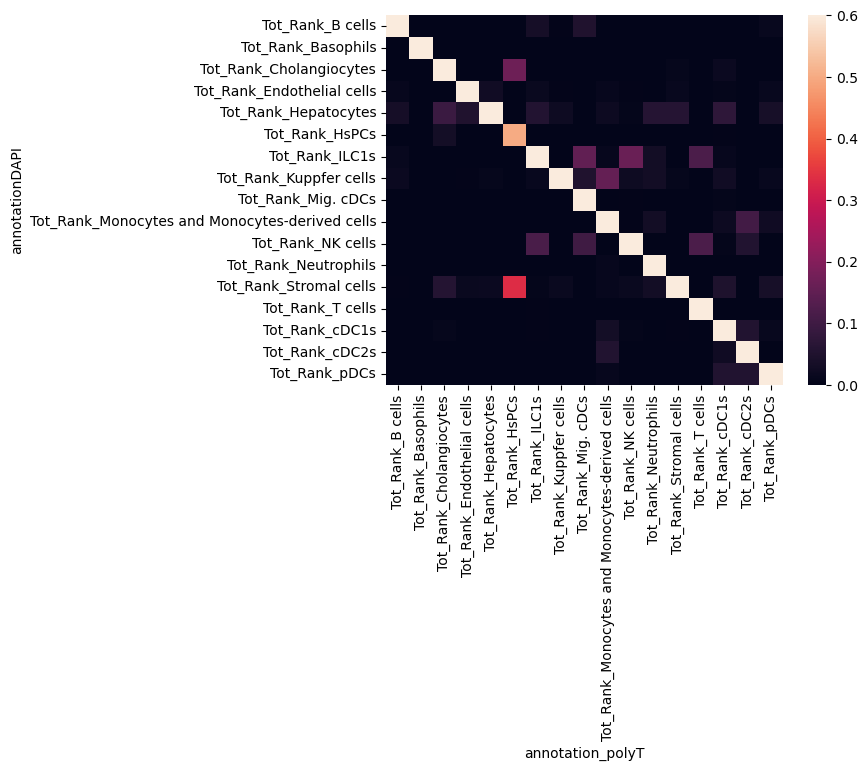

In [42]:
sns.heatmap(df_heatmap,vmax=0.6)
plt.show()

In [31]:
adataP.obs.loc[match_filtered['index_right'],:].maxScores.values

['Tot_Rank_Stromal cells', 'Tot_Rank_Hepatocytes', 'Tot_Rank_Hepatocytes', 'Tot_Rank_Hepatocytes', 'Tot_Rank_Hepatocytes', ..., 'Tot_Rank_Hepatocytes', 'Tot_Rank_Hepatocytes', 'Tot_Rank_Hepatocytes', 'Tot_Rank_Hepatocytes', 'Tot_Rank_Hepatocytes']
Length: 69857
Categories (17, object): ['Tot_Rank_B cells', 'Tot_Rank_Basophils', 'Tot_Rank_Cholangiocytes', 'Tot_Rank_Endothelial cells', ..., 'Tot_Rank_T cells', 'Tot_Rank_cDC1s', 'Tot_Rank_cDC2s', 'Tot_Rank_pDCs']

In [37]:
indices_double=match.groupby('index_right').count()[(match.groupby('index_right').count().matchedArea>2)]

<AxesSubplot:>

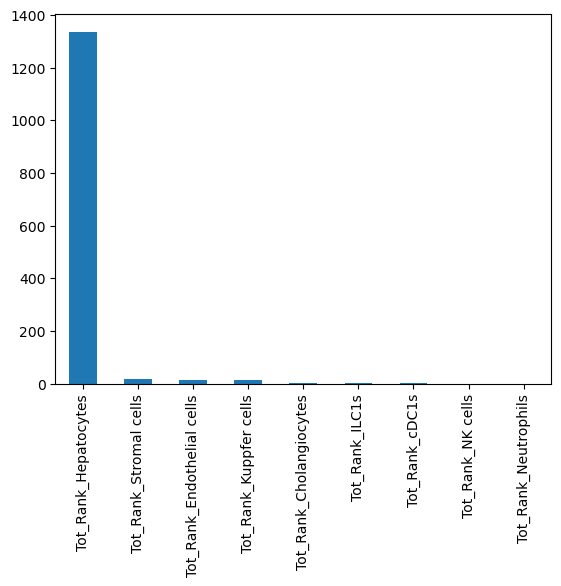

In [46]:
adataP[indices_double.index,:].obs.maxScores.value_counts().plot(kind='bar')

In [48]:
adataP[indices_double.index,:].obs.maxScores.value_counts()/1391

Tot_Rank_Hepatocytes          0.960460
Tot_Rank_Stromal cells        0.012221
Tot_Rank_Endothelial cells    0.010784
Tot_Rank_Kuppfer cells        0.010065
Tot_Rank_Cholangiocytes       0.002157
Tot_Rank_ILC1s                0.002157
Tot_Rank_cDC1s                0.001438
Tot_Rank_NK cells             0.000719
Tot_Rank_Neutrophils          0.000719
Name: maxScores, dtype: float64

In [50]:
adataP[indices_double.index,:].obs.total_counts.mean()

2941.4705

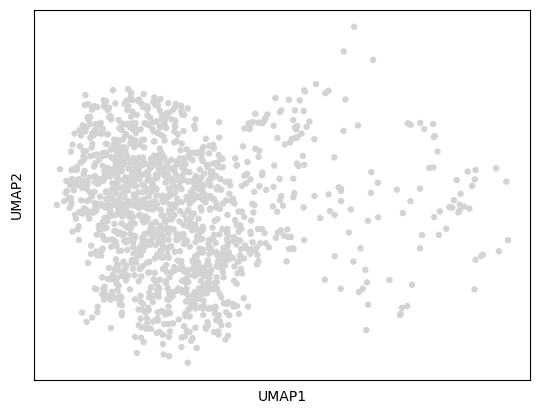

In [51]:
sc.pl.umap(adataP[indices_double.index,:])

In [56]:
sum(match.index_right.isnull()==False)

71927

In [16]:
 # Create geopandas objects with all info we need from the anndata object
geopD=geopandas.GeoDataFrame(adataD.obsm['polygons'].geometry,geometry=adataD.obsm['polygons'].geometry)
geopP=geopandas.GeoDataFrame(adataP.obsm['polygons'].geometry,geometry=adataP.obsm['polygons'].geometry)

#join based on interesects to see which nuclei overlap with which cells, these are the only possible matchups
possibilities=geopandas.sjoin(geopD,geopP,predicate='intersects',how='left')
#For now filter out the nucleis that don't overlap with any cell
#Vclean=possibilities.loc[np.isnan(possibilities.index_right)==False,:]

In [36]:
Vclean['matchedArea']=Vclean.intersection(geopP.loc[Vclean.index_right],align=False).area/Vclean.area


/tmp/ipykernel_59019/1953538003.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'area' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  Vclean['matchedArea']=Vclean.intersection(geopP.loc[Vclean.index_right],align=False).area/Vclean.area
/srv/scratch/lottep/anaconda3/envs/napari-spongepy/lib/python3.10/site-packages/geopandas/geodataframe.py:1472: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  super().__setitem__(key, value)


In [39]:
Vclean=Vclean.loc[Vclean.matchedArea>0,:]
Vclean.index=Vclean.index.rename('index')
    

In [32]:
Vclean=possibilities.loc[(possibilities.index_right.isnull())==False,:]

In [41]:
temp=Vclean.sort_values('matchedArea', ascending=False).loc[~Vclean.sort_values('matchedArea', ascending=False).index.duplicated(keep='first'),:]
temp.index=temp.index.rename('index')


In [42]:
geopandas.GeoDataFrame(adataD.obsm['polygons'].geometry,geometry=adataP.obsm['polygons'].geometry)

,geometry
index,
64,None
65,"MULTIPOLYGON (((7542.00000 7.00000, 7542.00000..."
67,"MULTIPOLYGON (((22527.00000 14.00000, 22527.00..."
70,None
71,"MULTIPOLYGON (((7813.00000 7449.00000, 7813.00..."
...,...
198669,None
198732,None
198858,None


In [43]:
len(np.unique(temp.index))

71927

In [45]:
polyT_match=pd.DataFrame(data=None,index=geopD.index)

polyT_match.index=polyT_match.index.rename('index')

In [46]:
polyT_match

""
index
64
65
67
70
71
...
198669
198732
198858


In [50]:
polyT_match=polyT_match.merge(temp,how='left',on='index')
polyT_match.drop(columns=['geometry'],inplace=True)

In [51]:
polyT_match

,index_right,matchedArea
index,,
64,128,1.000000
65,65,0.999932
67,67,0.705882
70,134,0.999024
71,71,1.000000
...,...,...
198669,192824,0.985188
198732,193006,0.887852
198858,193066,0.979016


In [53]:
match

,index_right,matchedArea
index,,
64,NaN,NaN
65,65,1.0
67,67,1.0
70,NaN,NaN
71,71,1.0
...,...,...
198669,NaN,NaN
198732,NaN,NaN
198858,NaN,NaN
